## Genre classification with the Million Song Dataset

The [Million Song Dataset](http://labrosa.ee.columbia.edu/millionsong/) is a 

>  freely-available collection of audio features and metadata for a million contemporary popular music tracks

originally collected and compiled by Thierry Bertin-Mahieux, Daniel P.W. Ellis, Brian Whitman, and Paul Lamere.

The dataset is intended to encourage development of algorithms in the field of [music information retrieval](https://en.wikipedia.org/wiki/Music_information_retrieval). The [data for each track](http://labrosa.ee.columbia.edu/millionsong/pages/example-track-description) includes both textual features such as artist and album names, numerical descriptors such as duration and various audio features derived using a music analysis platform provided by [The Echo Nest](https://en.wikipedia.org/wiki/The_Echo_Nest) (since acquired by Spotify). Of the various audio features and segmentations included in the full dataset, the most detailed information is included at a 'segment' level: each segment corresponds to an automatically identified 'quasi-stable music event' - roughly contiguous sections of the audio with similar perceptual quality. The number of segments per track is variable and each segment can itself be of variable length - typically they seem to be around 0.2 - 0.4 seconds but can be as long as 10 seconds or more. 

For each segment of the track various extracted audio features are available - a 12 dimensional vector of [chroma features](https://en.wikipedia.org/wiki/Chroma_feature), a 12 dimensional vector of ['MFCC-like'](https://en.wikipedia.org/wiki/Mel-frequency_cepstrum) timbre features and various measures of the loudness of the segment, including loudness at the segment start and maximum loudness.

#### EACH SEGMENT IS REPRESENTED BY THIS:
In the version of the data we provide, we include a 25 dimensional vector for each included segment, consisting of the 12 timbre features, 12 chroma features and loudness at start of segment concatenated in that order.

#### FEEDFORWARD
To allow easier integration in to standard feedforward models, the basic version of the data we provide includes features only for a fixed length crop of the central 120 segments of each track (with tracks with less than 120 segments therefore not being included).  
This gives an overall input dimension per track of 120×25=3000.

#### ALREADY NORMALIZED
Each of the 3000 input dimensions has been been preprocessed by subtracting the per-dimension mean across the training data and dividing by the per-dimension standard deviation across the training data.

We provide data providers for the fixed length crops versions of the input features, with the inputs being returned in batches of 3000 dimensional vectors (these can be reshaped to (120, 25) to get the per-segment features). To allow for more complex variable-length sequence modelling with for example recurrent neural networks, we also provide a variable length version of the data. This is only provided as compressed NumPy (`.npz`) data files rather than data provider objects - you will need to write your own data provider if you wish to use this version of the data. As the inputs are of variable number of segments they have been ['bucketed'](https://www.tensorflow.org/tutorials/seq2seq/#bucketing_and_padding) into groups of similar maximum length, with the following binning scheme used:

     120 - 250  segments
     251 - 500  segments
     501 - 650  segments
     651 - 800  segments
     801 - 950  segments
     951 - 1200 segments
    1201 - 2000 segments
    2000 - 4000 segments
    
For each bucket the NumPy data files include inputs and targets arrays with second dimension equal to the maximum segment size in the bucket (e.g. 250 for the bucket) and first dimension equal to the number of tracks with number of segments in that bucket. These are named `inputs_{n}` and `targets_{n}` in the data file where `{n}` is the maximal number of segments in the bucket e.g. `inputs_250` and `targets_250` for the first bucket. For tracks with less segments than the maximum size in the bucket, the features for the track have been padded with `NaN` values. For tracks with more segments than the maximum bucket size of 4000, only the first 4000 segments have been included.

To allow you to match tracks between the fixed length and variable length datasets, the data files also include an array for each bucket giving the indices of the corresponding track in the fixed length input arrays. For example the array `indices_250` will be an array of the same size as the first dimension of `inputs_250` and `targets_250` with the first element of `indices_250` giving the index into the `inputs` and `targets` array of the fixed length data corresponding to first element of `inputs_250` and `targets_250`.

The Million Song Dataset in its original form does not provide any genre labels, however various external groups have proposed genre labels for portions of the data by cross-referencing the track IDs against external music tagging databases. Analagously to the provision of both simpler and more complex classifications tasks for the CIFAR-10 / CIFAR-100 datasets, we provide two classification task datasets derived from the Million Song Dataset - one with 10 coarser level genre classes, and another with 25 finer-grained genre / style classifications.

The 10-genre classification task uses the [*CD2C tagtraum genre annotations*](http://www.tagtraum.com/msd_genre_datasets.html) derived from multiple source databases (beaTunes genre dataset, Last.fm dataset, Top-MAGD dataset), with the *CD2C* variant using only non-ambiguous annotations (i.e. not including tracks with multiple genre labels). Of the 15 genre labels provided in the CD2C annotations, 5 (World, Latin, Punk, Folk and New Age) were not included due to having fewer than 5000 examples available. This left 10 remaining genre classes:

    Rap
    Rock
    RnB
    Electronic
    Metal
    Blues
    Pop
    Jazz
    Country
    Reggae

For each of these 10 classes, 5000 labelled examples have been collected for training / validation (i.e. 50000 example in total) and a further 1000 example per class for testing, with the exception of the `Blues` class for which only 991 testing examples are provided due to there being insufficient labelled tracks of the minimum required length (i.e. a total of 9991 test examples). 

The 9991 test set examples have labels provided: however to avoid any accidental over-fitting to the test set **you should only use these for the final evaluation of your model(s)**. If you repeatedly evaluate models on the test set during model development it is easy to end up indirectly fitting to the test labels - for those who have not already read it see this [excellent cautionary note int the MLPR notes by Iain Murray](http://www.inf.ed.ac.uk/teaching/courses/mlpr/2016/notes/w2a_train_test_val.html#warning-dont-fool-yourself-or-make-a-fool-of-yourself). 


The 25-genre classification tasks uses the [*MSD Allmusic Style Dataset*](http://www.ifs.tuwien.ac.at/mir/msd/MASD.html) labels derived from the [AllMusic.com](http://www.allmusic.com/) database by [Alexander Schindler, Rudolf Mayer and Andreas Rauber of Vienna University of Technology](http://www.ifs.tuwien.ac.at/~schindler/pubs/ISMIR2012.pdf). The 25 genre / style labels used are:

    Big Band
    Blues Contemporary
    Country Traditional
    Dance
    Electronica
    Experimental
    Folk International
    Gospel
    Grunge Emo
    Hip Hop Rap
    Jazz Classic
    Metal Alternative
    Metal Death
    Metal Heavy
    Pop Contemporary
    Pop Indie
    Pop Latin
    Punk
    Reggae
    RnB Soul
    Rock Alternative
    Rock College
    Rock Contemporary
    Rock Hard
    Rock Neo Psychedelia
    
For each of these 25 classes, 2000 labelled examples have been collected for training / validation (i.e. 50000 example in total). A further 400 example per class have been collected for testing (i.e. 10000 examples in total), which you are provided inputs but not targets for. The optional Kaggle competition being run for this dataset (see email) is scored based on the 25-genre class label predictions on these unlabelled test inputs. 

The tracks used for the 25-genre classification task only partially overlap with those used for the 10-genre classification task and we do not provide any mapping between the two.

For each of the two tasks, the 50000 examples collected for training have been pre-split in to a 40000 example training dataset and a 10000 example validation dataset. If you wish to use a more complex cross-fold validation scheme you may want to combine these two portions of the dataset and define your own functions / classes for separating out a validation set.

Data provider classes for both fixed length input data for the 10 and 25 genre classification tasks in the `mlp.data_providers` module as `MSD10GenreDataProvider` and `MSD25GenreDataProvider`. Both have similar behaviour to the `MNISTDataProvider` used extensively last semester. A `which_set` argument can be used to specify whether to return a data provided for the training dataset (`which_set='train'`) or validation dataset (`which_set='valid'`).  Both data provider classes provide a `label_map` attribute which is a list of strings which are the class labels corresponding to the integer targets (i.e. prior to conversion to a 1-of-K encoded binary vector).

The test dataset files for the 10 genre classification task are provided as two separate NumPy data files `msd-10-genre-test-inputs.npz` and `msd-10-genre-test-targets.npz`. These can be loaded using [`np.load`](https://docs.scipy.org/doc/numpy/reference/generated/numpy.load.html) function. The inputs are stored as a $10000\times3000$ array under the key `inputs` in the file `msd-10-genre-test-inputs.npz` and the targets in a 10000 element array of integer labels under the key `targets` in `msd-10-genre-test-targets.npz`. A corresponding `msd-25-genre-test-inputs.npz` file is provided for the 25 genre task inputs.

### Accessing the Million Song Dataset data

Before using the data provider objects you will need to make sure the data files are accessible to the `mlp` package by existing under the directory specified by the `MLP_DATA_DIR` path.

The fixed length input data and associated targets is available as compressed NumPy `.npz` files

    msd-10-genre-train.npz          210MB
    msd-10-genre-valid.npz           53MB
    msd-10-genre-test-inputs.npz     53MB
    msd-10-genre-test-targets.npz   5.2KB
    msd-25-genre-train.npz          210MB
    msd-25-genre-valid.npz           53MB
    msd-25-genre-test-inputs.npz     53MB

in the AFS directory `/afs/inf.ed.ac.uk/group/teaching/mlp/data`.

If you are working on DICE one option is to redefine your `MLP_DATA_DIR` to directly point to the shared AFS data directory by editing the `env_vars.sh` start up file for your environment. This will avoid using up your DICE quota by storing the data files in your homespace but may involve slower initial loading of the data on initialising the data providers if many people are trying access the same files at once. The environment variable can be redefined by running

```
gedit ~/miniconda2/envs/mlp/etc/conda/activate.d/env_vars.sh
```

in a terminal window (assuming you installed `miniconda2` to your home directory), and changing the line

```
export MLP_DATA_DIR=$HOME/mlpractical/data
```

to

```
export MLP_DATA_DIR="/afs/inf.ed.ac.uk/group/teaching/mlp/data"
```

and then saving and closing the editor. You will need reload the `mlp` environment using `source activate mlp` and restart the Jupyter notebook server in the reloaded environment for the new environment variable definition to be available.

For those working on DICE who have sufficient quota remaining or those using there own machine, an alternative option is to copy the data files in to your local `mlp/data` directory (or wherever your `MLP_DATA_DIR` environment variable currently points to if different). 


Assuming your local `mlpractical` repository is in your home directory you should be able to copy the required files on DICE by running

```
cp /afs/inf.ed.ac.uk/group/teaching/mlp/data/msd-*-train.npz ~/mlpractical/data
cp /afs/inf.ed.ac.uk/group/teaching/mlp/data/msd-*-valid.npz ~/mlpractical/data
cp /afs/inf.ed.ac.uk/group/teaching/mlp/data/msd-*-test-*.npz ~/mlpractical/data
```

On a non-DICE machine, you will need to either [set up local access to AFS](http://computing.help.inf.ed.ac.uk/informatics-filesystem), use a remote file transfer client like `scp` or you can alternatively download the files using the iFile web interface [here](https://ifile.inf.ed.ac.uk/?path=%2Fafs%2Finf.ed.ac.uk%2Fgroup%2Fteaching%2Fmlp%2Fdata&goChange=Go) (requires DICE credentials).

As some of the files are quite large you may wish to copy only those you are using (e.g. only the files for one of the two tasks) to your local filespace to avoid filling up your quota. The `msd-25-genre-test-inputs.npz` files will only be needed by those intending to enter the associated optional Kaggle competition.

In addition to the fixed length input files there are also corresponding files with the variable length input data in the same AFS directory

    msd-10-genre-train-var-length.npz          1.6GB
    msd-10-genre-valid-var-length.npz          403MB
    msd-10-genre-test-inputs-var-length.npz    403MB
    msd-10-genre-test-targets-var-length.npz   3.1KB
    msd-25-genre-train-var-length.npz          1.5GB
    msd-25-genre-valid-var-length.npz          367MB
    msd-25-genre-test-inputs-var-length.npz    363MB
    
As you can see some of these files, particularly the training sets, are very large so you will need to be careful if copying to your filespace to make sure you have sufficient quota available.

## Two-layer classifier models

Below example code is given for creating instances of the 10-genre and 25-genre fixed-length input data provider objects and using them to train simple two-layer feedforward network models with rectified linear activations in TensorFlow.

In [2]:
import sys
mlpdir = '/home/student/Dropbox/msc_Artificial_Intelligence/mlp_Machine_Learning_Practical/mlpractical'
sys.path.append(mlpdir)

In [3]:
from mylibs.jupyter_notebook_helper import show_graph
import datetime
import os
import time
import tensorflow as tf
import numpy as np
from mlp.data_providers import MSD10GenreDataProvider, MSD25GenreDataProvider,\
    MSD10Genre_Autoencoder_DataProvider, MSD10Genre_StackedAutoEncoderDataProvider
import matplotlib.pyplot as plt
%matplotlib inline

In [4]:
tensorboardLogdir = 'tf_cw3_1'

In [5]:
seed = 16011984
rng = np.random.RandomState(seed=seed)

In [6]:
config = tf.ConfigProto(log_device_placement=True, allow_soft_placement=True)
config.gpu_options.allow_growth = True

In [7]:
def getRunTime(function): #a = lambda _ = None : 3
    run_start_time = time.time()
    result = function()
    run_time = time.time() - run_start_time
    return result, run_time

In [8]:
def getNewSessionInitialized(graph=tf.get_default_graph()):
    #with graph.as_default():
    sess = tf.InteractiveSession(graph=graph, config=config)
    #sess = tf.Session(graph=graph)
    sess.run(tf.global_variables_initializer())
        
    return sess

In [9]:
def getWriter(key, graph):
    #tensorboard --logdir=...
    folder = tensorboardLogdir

    timestamp = datetime.datetime.now().strftime("%Y-%m-%d_%H-%M-%S")
    return tf.summary.FileWriter(
        logdir=os.path.join(folder, timestamp, key),
        graph=graph
    )

In [10]:
def getTrainWriter():
    return getWriter('train', tf.get_default_graph())

In [11]:
def getValidWriter():
    return getWriter('valid', tf.get_default_graph())

In [12]:
def plotStats(stats, keys, stats_interval):
    # Plot the change in the validation and training set error over training.
    
    #stats[0:, keys[k]] #0 epoch number
    #stats[1:, keys[k]] #1 for training and validation
    #keys is from string to index
    #stats shape is [epochs, 4]
    
    fig_1 = plt.figure(figsize=(8, 4))
    ax_1 = fig_1.add_subplot(111)
    for k in ['error(train)', 'error(valid)']:
        ax_1.plot(np.arange(1, stats.shape[0]) * stats_interval, 
                  stats[1:, keys[k]], label=k)
    ax_1.legend(loc=0)
    ax_1.set_xlabel('Epoch number')

    # Plot the change in the validation and training set accuracy over training.
    fig_2 = plt.figure(figsize=(8, 4))
    ax_2 = fig_2.add_subplot(111)
    for k in ['acc(train)', 'acc(valid)']:
        ax_2.plot(np.arange(1, stats.shape[0]) * stats_interval, 
                  stats[1:, keys[k]], label=k)
    ax_2.legend(loc=0)
    ax_2.set_xlabel('Epoch number')
    
    return fig_1, ax_1, fig_2, ax_2

In [13]:
def fully_connected_layer(inputs, input_dim, output_dim, nonlinearity=tf.nn.relu, avoidDeadNeurons=0.,
                          w=None, b=None):
    weights = tf.Variable(
        tf.truncated_normal([input_dim, output_dim], stddev=2. / (input_dim + output_dim)**0.5) if w is None else w,
            'weights'
    )
    
    biases = tf.Variable(avoidDeadNeurons * tf.ones([output_dim]) if b is None else b, 'biases')
    outputs = nonlinearity(tf.matmul(inputs, weights) + biases)
    return outputs

In [14]:
def tfRMSE(outputs, targets):
    return tf.sqrt(tf.reduce_mean(tf.square(tf.sub(targets, outputs))))

In [15]:
def tfMSE(outputs, targets):
    return tf.reduce_mean(tf.square(tf.sub(targets, outputs)))

In [16]:
def initStats():
    stats = np.zeros( (epochs,4) )

    #define variables
    train_error = 0.
    train_accuracy = 0.
    valid_error = 0.
    valid_accuracy = 0.
    
    keys = {
        'error(train)': 0,
        'acc(train)': 1,
        'error(valid)': 2,
        'acc(valid)': 3
    }

    return stats, train_error, train_accuracy, valid_error, valid_accuracy, keys

In [17]:
def gatherStats(e, train_error, train_accuracy, valid_error, valid_accuracy):
    stats[e, 0] = train_error
    stats[e, 1] = train_accuracy
    stats[e, 2] = valid_error
    stats[e, 3] = valid_accuracy

In [18]:
figcount = 0

### MSD 10 genre task

In [19]:
train_data = MSD10GenreDataProvider('train', batch_size=50, rng=rng) #((50, 3000), (50, 10))
valid_data = MSD10GenreDataProvider('valid', batch_size=50, rng=rng)

In [19]:
num_hidden = 200

In [20]:
tf.reset_default_graph()

inputs = tf.placeholder(tf.float32, [None, train_data.inputs.shape[1]], 'inputs')
targets = tf.placeholder(tf.float32, [None, train_data.num_classes], 'targets')

with tf.name_scope('fullyConnected-1'):
    hidden_1 = fully_connected_layer(inputs, train_data.inputs.shape[1], num_hidden, avoidDeadNeurons=0.1)

with tf.name_scope('output-layer'):
    outputs = fully_connected_layer(hidden_1, num_hidden, train_data.num_classes, nonlinearity=tf.identity)

with tf.name_scope('error'):
    error = tf.reduce_mean(tf.nn.softmax_cross_entropy_with_logits(outputs, targets))
    
with tf.name_scope('accuracy'):
    accuracy = tf.reduce_mean(tf.cast(tf.equal(tf.argmax(outputs, 1), tf.argmax(targets, 1)), tf.float32))

with tf.name_scope('train'):
    train_step = tf.train.AdamOptimizer().minimize(error)
    
init = tf.global_variables_initializer()

tf.summary.scalar('error', error)
tf.summary.scalar('accuracy', accuracy)
summary_op = tf.summary.merge_all()

In [21]:
show_graph(tf.get_default_graph())

In [22]:
train_writer = getTrainWriter()
valid_writer = getValidWriter()

sess = tf.InteractiveSession(config=config)
sess.run(init)

In [23]:
def trainEpoch(train_error, train_accuracy):
    train_error = 0.
    train_accuracy = 0.
    
    for step, (input_batch, target_batch) in enumerate(train_data):
        _, batch_error, batch_acc, summary = sess.run(
            [train_step, error, accuracy, summary_op], 
            feed_dict={inputs: input_batch, targets: target_batch}
        )
        
        train_error += batch_error
        train_accuracy += batch_acc
        
        train_writer.add_summary(summary, global_step= e * train_data.num_batches + step)
    
    train_error /= train_data.num_batches
    
    train_accuracy /= train_data.num_batches
    
    return train_error, train_accuracy

End epoch 01 (5.957 secs): err(train)=2.08 acc(train)=0.39
End epoch 02 (5.586 secs): err(train)=1.17 acc(train)=0.60
End epoch 03 (5.148 secs): err(train)=0.89 acc(train)=0.70
End epoch 04 (4.937 secs): err(train)=0.63 acc(train)=0.79
End epoch 05 (4.988 secs): err(train)=0.41 acc(train)=0.86
                           err(valid)=2.71 acc(valid)=0.41
End epoch 06 (5.373 secs): err(train)=0.29 acc(train)=0.91
End epoch 07 (5.083 secs): err(train)=0.21 acc(train)=0.93
End epoch 08 (5.688 secs): err(train)=0.20 acc(train)=0.93
End epoch 09 (4.924 secs): err(train)=0.20 acc(train)=0.93
End epoch 10 (4.965 secs): err(train)=0.16 acc(train)=0.95
                           err(valid)=4.60 acc(valid)=0.42
End epoch 11 (4.947 secs): err(train)=0.13 acc(train)=0.96
End epoch 12 (4.869 secs): err(train)=0.14 acc(train)=0.95
End epoch 13 (4.921 secs): err(train)=0.14 acc(train)=0.96
End epoch 14 (4.963 secs): err(train)=0.13 acc(train)=0.96
End epoch 15 (5.066 secs): err(train)=0.11 acc(train)=0.

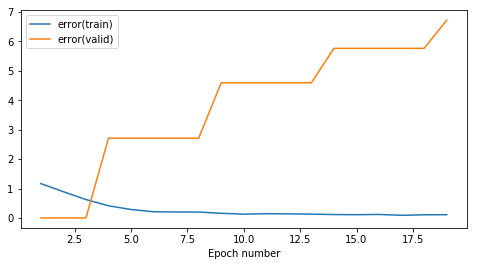

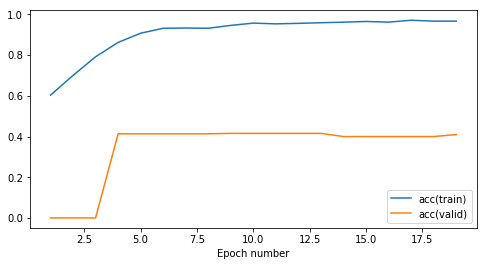

In [24]:
epochs = 20
#with tf.Session() as sess:

stats, train_error, train_accuracy, valid_error, valid_accuracy, keys = initStats()

for e in range(epochs):    
    (train_error, train_accuracy), runTime = getRunTime(lambda _ = None: trainEpoch(train_error, train_accuracy))
        
    print 'End epoch %02d (%.3f secs): err(train)=%.2f acc(train)=%.2f' % (e+1, runTime, train_error,train_accuracy)
    
    if (e + 1) % 5 == 0:
        valid_error = 0.
        valid_accuracy = 0.
        for step, (input_batch, target_batch) in enumerate(valid_data):
            batch_error, batch_acc, summary = sess.run(
                [error, accuracy, summary_op], 
                feed_dict={inputs: input_batch, targets: target_batch})
            valid_error += batch_error
            valid_accuracy += batch_acc
            
            valid_writer.add_summary(summary, global_step= e * train_data.num_batches + step)
            
        valid_error /= valid_data.num_batches
        valid_accuracy /= valid_data.num_batches
        
        print((' ' * 27) + 'err(valid)={0:.2f} acc(valid)={1:.2f}'.format(valid_error, valid_accuracy))
    

    gatherStats(e, train_error, train_accuracy, valid_error, valid_accuracy)
            
train_writer.flush()
valid_writer.flush()

fig_1, ax_1, fig_2, ax_2 = plotStats(stats, keys, stats_interval=1)
figcount += 1
fig_1.savefig('cw3_part1_%02d_fig_error.svg' % figcount)
fig_2.savefig('cw3_part1_%02d_fig_valid.svg' % figcount)

## Pretraining helps?

In [40]:
data_provider = MSD10Genre_Autoencoder_DataProvider('train', batch_size=50, rng=rng) #((50, 3000), (50, 10))

In [41]:
inputOutputDim = data_provider.inputs.shape[1]

In [42]:
hiddenDim = 200

In [43]:
graph = tf.Graph() #create new graph

In [44]:
with graph.as_default():
    inputs = tf.placeholder(tf.float32, [None, inputOutputDim], 'inputs')
    targets = tf.placeholder(tf.float32, [None, inputOutputDim], 'targets')

    with tf.name_scope('fullyConnected'):
        hidden_layer = fully_connected_layer(inputs, inputOutputDim, hiddenDim, nonlinearity = tf.nn.sigmoid)

    with tf.name_scope('outputLayer'):
        outputs = fully_connected_layer(hidden_layer, hiddenDim, inputOutputDim, nonlinearity = tf.nn.sigmoid)

    with tf.name_scope('error'):
        error = tfMSE(outputs, targets)

    with tf.name_scope('trainAutoEncoder'):
        train_step = tf.train.AdamOptimizer().minimize(error)

    init = tf.global_variables_initializer()

In [45]:
show_graph(graph)

In [46]:
def trainAutoencoder(train_error):
    for step, (input_batch, target_batch) in enumerate(data_provider):
        _, batch_error = sess.run(
            [train_step, error], 
            feed_dict={inputs: input_batch, targets: target_batch})
        
        train_error += batch_error
        
    return train_error

In [47]:
sess = tf.InteractiveSession(graph=graph, config=config)

In [48]:
epochs = 20

In [52]:
sess.run(init)

train_errors = []

for e in range(epochs):
    train_error = 0.
    
    train_error, runTime = getRunTime(lambda _ = None: trainAutoencoder(train_error)) 
        
    train_error /= data_provider.num_batches
    
    train_errors.append(train_error)
        
    print 'End epoch %02d (%.3f secs): err(train)=%.2f' % (e+1, runTime, train_error)

End epoch 01 (9.305 secs): err(train)=0.93
End epoch 02 (9.034 secs): err(train)=0.89
End epoch 03 (8.751 secs): err(train)=0.87
End epoch 04 (8.809 secs): err(train)=0.86
End epoch 05 (8.800 secs): err(train)=0.85
End epoch 06 (8.762 secs): err(train)=0.85
End epoch 07 (8.745 secs): err(train)=0.84
End epoch 08 (8.770 secs): err(train)=0.84
End epoch 09 (8.758 secs): err(train)=0.83
End epoch 10 (8.787 secs): err(train)=0.83
End epoch 11 (8.751 secs): err(train)=0.83
End epoch 12 (8.768 secs): err(train)=0.82
End epoch 13 (8.778 secs): err(train)=0.82
End epoch 14 (9.297 secs): err(train)=0.82
End epoch 15 (8.750 secs): err(train)=0.82
End epoch 16 (8.780 secs): err(train)=0.82
End epoch 17 (8.747 secs): err(train)=0.82
End epoch 18 (8.865 secs): err(train)=0.82
End epoch 19 (8.758 secs): err(train)=0.82
End epoch 20 (9.044 secs): err(train)=0.82


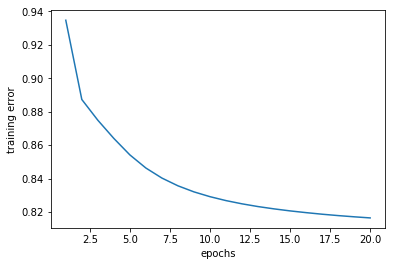

In [53]:
fig = plt.figure()
plt.plot(np.arange(epochs) + 1, train_errors)
plt.xlabel('epochs')
plt.ylabel('training error')
plt.show()
figcount += 1
fig.savefig('cw3_part1_%02d_fig_error_autoencoder.svg' % figcount)

#### Conclusion 
Here we used non-linear autoencoder with sigmoid non-linearities of hidden dimensionality of 200.

The result from the experiment above is that the hidden dimensionality of 200 seems too little to autoencode the data. The error of 0.82 where the autoencoder converged before than 20 epochs means that we could perhaps do better with a larger dimensionality

In [55]:
def executeNonLinearAutoencoder(inputOutputDim, hiddenDim, dataProvider,
                                numEpochs=20, errorFunc = tfMSE,
                               nonLinearLayer1 = tf.nn.sigmoid, nonLinearLayer2=tf.nn.sigmoid, printing=True):
    #inputOutputDim = dataProvider.inputs.shape[1]
    
    graph = tf.Graph() #create new graph
    
    with graph.as_default():
        inputs = tf.placeholder(tf.float32, [None, inputOutputDim], 'inputs')
        targets = tf.placeholder(tf.float32, [None, inputOutputDim], 'targets')

        with tf.name_scope('fullyConnected'):
            hidden_layer = fully_connected_layer(inputs, inputOutputDim, hiddenDim, nonlinearity = nonLinearLayer1)

        with tf.name_scope('outputLayer'):
            outputs = fully_connected_layer(hidden_layer, hiddenDim, inputOutputDim, nonlinearity = nonLinearLayer2)

        with tf.name_scope('error'):
            error = errorFunc(outputs, targets)

        with tf.name_scope('trainAutoEncoder'):
            train_step = tf.train.AdamOptimizer().minimize(error)

        init = tf.global_variables_initializer()
    
    
    def trainAutoencoder(train_error):
        for step, (input_batch, target_batch) in enumerate(dataProvider):
            _, batch_error = sess.run(
                [train_step, error], 
                feed_dict={inputs: input_batch, targets: target_batch})

            train_error += batch_error

        return train_error
    
    sess = tf.InteractiveSession(graph=graph, config=config)

    sess.run(init)

    totalRuntime = 0.
    
    train_errors = []
    
    for e in range(numEpochs):
        train_error = 0.

        train_error, runTime = getRunTime(lambda _ = None: trainAutoencoder(train_error)) 

        train_error /= dataProvider.num_batches
        
        train_errors.append(train_error)

        totalRuntime += runTime
        
        if printing:
            print 'End epoch %02d (%.3f secs): err(train)=%.2f' % (e+1, runTime, train_error)
    
    #TODO dropUnnecessaryAutoencoderLayers = lambda model: MultipleLayerModel(model.layers[:-2])

    #TODO return dropUnnecessaryAutoencoderLayers(model), stats, keys, runTime
    
    weights, biases = [v.eval() for v in tf.trainable_variables() if "fullyConnected" in v.name]
    assert weights.shape[1] == len(biases)
    
    return graph, weights, biases, totalRuntime, train_errors

In [57]:
epochs = 20

_, _, _, totalRuntime, train_errors = executeNonLinearAutoencoder( numEpochs=epochs,
    inputOutputDim= 3000, hiddenDim=400,
    dataProvider=MSD10Genre_Autoencoder_DataProvider('train', batch_size=50, rng=rng)
)

print "total run time: %.2f" % totalRuntime

End epoch 01 (14.750 secs): err(train)=0.91
End epoch 02 (14.857 secs): err(train)=0.86
End epoch 03 (14.561 secs): err(train)=0.84
End epoch 04 (14.538 secs): err(train)=0.82
End epoch 05 (14.528 secs): err(train)=0.80
End epoch 06 (14.600 secs): err(train)=0.80
End epoch 07 (14.530 secs): err(train)=0.79
End epoch 08 (14.540 secs): err(train)=0.78
End epoch 09 (14.531 secs): err(train)=0.78
End epoch 10 (14.520 secs): err(train)=0.78
End epoch 11 (14.520 secs): err(train)=0.77
End epoch 12 (14.554 secs): err(train)=0.77
End epoch 13 (14.514 secs): err(train)=0.77
End epoch 14 (14.623 secs): err(train)=0.77
End epoch 15 (14.519 secs): err(train)=0.77
End epoch 16 (14.535 secs): err(train)=0.77
End epoch 17 (14.519 secs): err(train)=0.76
End epoch 18 (14.569 secs): err(train)=0.76
End epoch 19 (14.542 secs): err(train)=0.76
End epoch 20 (14.532 secs): err(train)=0.76
total run time: 291.38


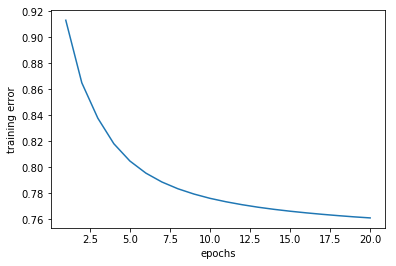

In [58]:
fig = plt.figure()
plt.plot(np.arange(epochs) + 1, train_errors)
plt.xlabel('epochs')
plt.ylabel('training error')
plt.show()
figcount += 1
fig.savefig('cw3_part1_%02d_fig_error_autoencoder.svg' % figcount)

#### Conclusion
Here we see that the performance in terms of speed is worse but in terms of autoencoding, the performance is better

#### More infrastructure
We need to create a function that constructs a new model out of pretrained autoencoder stack

In [62]:
def buildGraphOfStackedAutoencoder(inDim, variables, nonlinearity=tf.nn.sigmoid, avoidDeadNeurons = 0.,
                                  lastNonLinearity=tf.nn.sigmoid):
    graph = tf.Graph() #create new graph
    
    with graph.as_default():
        inputs = tf.placeholder(tf.float32, [None, inDim], 'inputs')

        #with tf.name_scope('fullyConnected'):
        
        layer = inputs
        #inDim = inDim
        
        for i, (weights, biases) in enumerate(variables): #[3000x400], [400,]
            outDim = len(biases)
            
            curNonLinearity = lastNonLinearity if i+1 == len(variables) else nonlinearity
            
            layer = fully_connected_layer(layer, inDim, outDim, nonlinearity = curNonLinearity, w=weights, b=biases,
                                         avoidDeadNeurons = avoidDeadNeurons)
            
            inDim = outDim

        init = tf.global_variables_initializer()
        
        outputs = layer
        
    return graph, init, inputs, outputs

In [63]:
def constructModelFromPretrainedByAutoEncoderStack(hiddenDimLayers, autoencoder, inputDim = 3000,
                                                   batchSize=50, rng=rng):
    #preTrainedModels = []
    curInputDim = inputDim
    curProcessBatch = None
    
    variables = []
    
    #count = 0
    train_errors_groups = []
    
    for hiddenDimLayer in hiddenDimLayers:
        dataProvider = MSD10Genre_StackedAutoEncoderDataProvider(
            'train', batch_size=batchSize, rng=rng, processBatch = curProcessBatch
        )
        
        _, weights, biases, _, train_errors = autoencoder(curInputDim, hiddenDimLayer, dataProvider) #graph, w, b, runTime
        
        train_errors_groups.append(train_errors)
        
        variables.append((weights, biases))
        
        graph, init, inputs, outputs = buildGraphOfStackedAutoencoder(inputDim, variables) #recreate it from scratch actually
        
        #count += 1
        
        def processBatchFunc(inputBatch): #this is redefined automatically, no need to do any special code here
            """process batch should calculate fprop for inputBatch"""
            with tf.Session(graph=graph, config=config) as sess:
                sess.run(init)
            
                (outValue, ) = sess.run([outputs], feed_dict={inputs: inputBatch})
            
            #print "count now is: %d" % count

            return outValue
        
        curProcessBatch = processBatchFunc
        
        curInputDim = hiddenDimLayer
        
    return variables, train_errors_groups

In [65]:
filename = 'pretrainedShallowModelVars.npz'

if not os.path.isfile(filename):
    modelVars, train_errors_groups = constructModelFromPretrainedByAutoEncoderStack([400, 10], executeNonLinearAutoencoder)
    np.savez(filename, modelVars, train_errors_groups)

else:
    loadedFile = np.load(filename)
    modelVars = loadedFile[loadedFile.keys()[0]]
    train_errors_groups = loadedFile[loadedFile.keys()[1]]

In [69]:
#expand the model to make it complete
graph, init, inputs, outputs = buildGraphOfStackedAutoencoder(inDim = 3000,
                                                              variables = modelVars,
                                                              lastNonLinearity = tf.identity)

In [70]:
outputs.get_shape()

TensorShape([Dimension(None), Dimension(10)])

In [71]:
with graph.as_default():
    targets = tf.placeholder(tf.float32, [None, 10], 'targets') #since we have 10 classes to classify from
    
    with tf.name_scope('error'):
        error = tf.reduce_mean(tf.nn.softmax_cross_entropy_with_logits(outputs, targets))

    with tf.name_scope('accuracy'):
        accuracy = tf.reduce_mean(tf.cast(tf.equal(tf.argmax(outputs, 1), tf.argmax(targets, 1)), tf.float32))

    with tf.name_scope('train'):
        train_step = tf.train.AdamOptimizer().minimize(error)

    init = tf.global_variables_initializer()

    tf.summary.scalar('error', error)
    tf.summary.scalar('accuracy', accuracy)
    summary_op = tf.summary.merge_all()

In [72]:
show_graph(graph)

In [73]:
train_data = MSD10GenreDataProvider('train', batch_size=50, rng=rng) #((50, 3000), (50, 10))
valid_data = MSD10GenreDataProvider('valid', batch_size=50, rng=rng)

In [74]:
def trainEpoch(train_error, train_accuracy):
    train_error = 0.
    train_accuracy = 0.
    
    for step, (input_batch, target_batch) in enumerate(train_data):
        _, batch_error, batch_acc, summary = sess.run(
            [train_step, error, accuracy, summary_op], 
            feed_dict={inputs: input_batch, targets: target_batch}
        )
        
        train_error += batch_error
        train_accuracy += batch_acc
        
        train_writer.add_summary(summary, global_step= e * train_data.num_batches + step)
    
    train_error /= train_data.num_batches
    
    train_accuracy /= train_data.num_batches
    
    return train_error, train_accuracy

End epoch 01 (9.239 secs): err(train)=1.67 acc(train)=0.41
End epoch 02 (8.607 secs): err(train)=1.30 acc(train)=0.56
End epoch 03 (8.788 secs): err(train)=0.98 acc(train)=0.69
End epoch 04 (8.881 secs): err(train)=0.64 acc(train)=0.83
End epoch 05 (8.515 secs): err(train)=0.34 acc(train)=0.94
                           err(valid)=2.07 acc(valid)=0.39
End epoch 06 (9.296 secs): err(train)=0.16 acc(train)=0.98
End epoch 07 (8.480 secs): err(train)=0.07 acc(train)=1.00
End epoch 08 (8.216 secs): err(train)=0.03 acc(train)=1.00
End epoch 09 (8.938 secs): err(train)=0.02 acc(train)=1.00
End epoch 10 (9.164 secs): err(train)=0.01 acc(train)=1.00
                           err(valid)=2.66 acc(valid)=0.39
End epoch 11 (8.498 secs): err(train)=0.01 acc(train)=1.00
End epoch 12 (8.489 secs): err(train)=0.00 acc(train)=1.00
End epoch 13 (8.418 secs): err(train)=0.00 acc(train)=1.00
End epoch 14 (8.300 secs): err(train)=0.00 acc(train)=1.00
End epoch 15 (8.289 secs): err(train)=0.00 acc(train)=1.

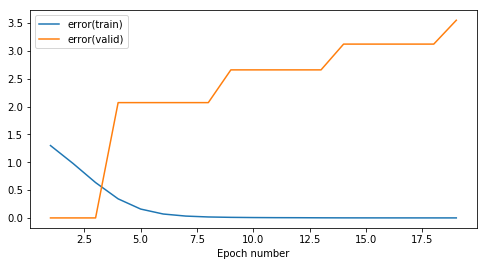

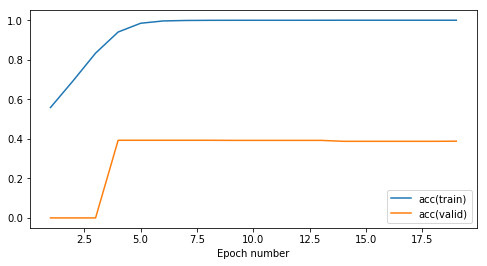

In [75]:
train_writer = getTrainWriter()
valid_writer = getValidWriter()

epochs = 20

stats, train_error, train_accuracy, valid_error, valid_accuracy, keys = initStats()

with tf.Session(graph=graph, config=config) as sess:
    sess.run(init)    
    
    for e in range(epochs):
        (train_error, train_accuracy), runTime = getRunTime(lambda _ = None: trainEpoch(train_error, train_accuracy))

        print 'End epoch %02d (%.3f secs): err(train)=%.2f acc(train)=%.2f' % (e+1, runTime, train_error,train_accuracy)

        if (e + 1) % 5 == 0:
            valid_error = 0.
            valid_accuracy = 0.
            for step, (input_batch, target_batch) in enumerate(valid_data):
                batch_error, batch_acc, summary = sess.run(
                    [error, accuracy, summary_op], 
                    feed_dict={inputs: input_batch, targets: target_batch})
                valid_error += batch_error
                valid_accuracy += batch_acc

                valid_writer.add_summary(summary, global_step= e * train_data.num_batches + step)

            valid_error /= valid_data.num_batches
            valid_accuracy /= valid_data.num_batches

            print((' ' * 27) + 'err(valid)={0:.2f} acc(valid)={1:.2f}'.format(valid_error, valid_accuracy))


        gatherStats(e, train_error, train_accuracy, valid_error, valid_accuracy)
            
train_writer.flush()
valid_writer.flush()

fig_1, ax_1, fig_2, ax_2 = plotStats(stats, keys, stats_interval=1)
figcount += 1
fig_1.savefig('cw3_part1_%02d_fig_error.svg' % figcount)
fig_2.savefig('cw3_part1_%02d_fig_valid.svg' % figcount)

#### Conclusion
The answer is no. The pretraining at least for this shallow neural network with one hidden layer of 400 is not able to help at all. We have not started at a better place than before as we were hoping to.